# Машинное обучение, ВМК МГУ

# Практическое задание 1. Обучение без учителя.

## Общая информация
Дата выдачи: 22.02.2024

Мягкий дедлайн: 07.03.2024 23:59 MSK

Жёсткий дедлайн: 14.03.2024 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-1-Username.ipynb

Username — ваша фамилия на латинице

## О задании



В этом задании вам предлагается поработать с различными методами кластеризации и посмотреть их работу на различных данных

In [1]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

## Часть 1. Тематическое моделирование текстов.

В этом задании мы сравним разные алгоритмы кластеризации для задачи тематического моделирования.

**Задание 1.1 (1 балл).** Для начала реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Здесь необходимо использовать вариацию с ненормированным лапласианом.

In [2]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''
        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        D = np.diag(X.sum(axis=1))
        L = D - X
        _, eigenvectors = np.linalg.eigh(L)
        return eigenvectors[:, :self.n_components]

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [3]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)
true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

/Users/nikto/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


**Задание 1.2 (0.5 балла)** Теперь приступим к применению разных алгоритмов кластеризации для одной из самых популярных задач обучения без учителя: задачи тематического моделирования текстов.

Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. То есть, фактически, перед вами стоит задача кластеризации текстов с тем лишь дополнением что требется не только разбить тексты на группы, но и выделить ключевые слова, определяющие каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [4]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
337,business,338.txt,Police detain Chinese milk bosses,Chinese police have detained three top execut...
684,entertainment,175.txt,Alicia Keys to open US Super Bowl,R&B star Alicia Keys is to open February's Su...
828,entertainment,319.txt,Music mogul Fuller sells company,Pop Idol supremo Simon Fuller has sold his 19...
903,politics,008.txt,Women MPs reveal sexist taunts,"Women MPs endure ""shocking"" levels of sexist ..."
2205,tech,382.txt,Tough rules for ringtone sellers,Firms that flout rules on how ringtones and o...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [5]:
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
import re

In [6]:
lemmatizer = WordNetLemmatizer()

def prepare(s):
    s = re.sub(r'[^a-zA-Z ]', '', s)
    l = word_tokenize(s)
    l = [lemmatizer.lemmatize(word) for word in l]
    l = [word for word in l if word not in stopwords.words('english')]
    return ' '.join(l)

In [7]:
%%time
data['text'] = (data['title'] + data['content']).str.lower().apply(prepare)

CPU times: user 56.1 s, sys: 10.8 s, total: 1min 6s
Wall time: 1min 7s


In [8]:
data['text']

0       ad sale boost time warner profit quarterly pro...
1       dollar gain greenspan speech dollar ha hit hig...
2       yukos unit buyer face loan claim owner embattl...
3       high fuel price hit ba profit british airway h...
4       pernod takeover talk lift domecq share uk drin...
                              ...                        
2220    bt program beat dialler scam bt introducing tw...
2221    spam email tempt net shopper computer user acr...
2222    careful code new european directive could put ...
2223    u cyber security chief resigns man making sure...
2224    losing online gaming online role playing game ...
Name: text, Length: 2225, dtype: object

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [9]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    joint_texts = ' '.join(texts)
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

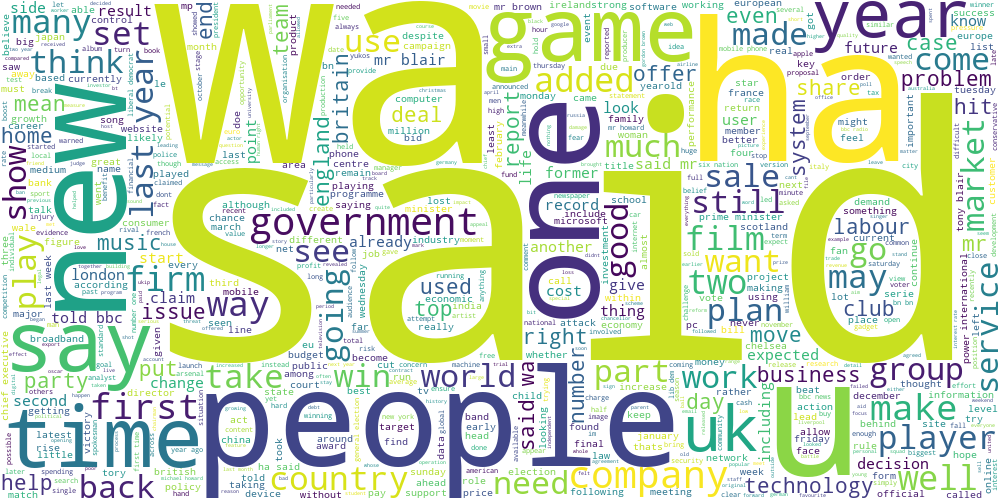

In [10]:
draw_wordcloud(data.text)

**Задание 1.3 (1 балл).** Начнем с простого: обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. (?) Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:**
Темы получились достаточно интерпретируемыми:
- Технологии/девайсы
- Новости US/UK
- Кинематограф (большая часть про церемонию Оскар)
- Дебаты политических деятелей?
- Экономика US

In [11]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder

In [12]:
le = LabelEncoder()
y = le.fit(data['category']).transform(data['category'])
y

array([0, 0, 0, ..., 4, 4, 4])

In [13]:
vectorizer = TfidfVectorizer(min_df=0.0005, lowercase=False)
X = vectorizer.fit_transform(data['text'])
X

<2225x15940 sparse matrix of type '<class 'numpy.float64'>'
	with 321264 stored elements in Compressed Sparse Row format>

In [14]:
n_clusters = 8
kmeans = KMeans(n_clusters=n_clusters)
labels = kmeans.fit_predict(X)

/Users/nikto/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


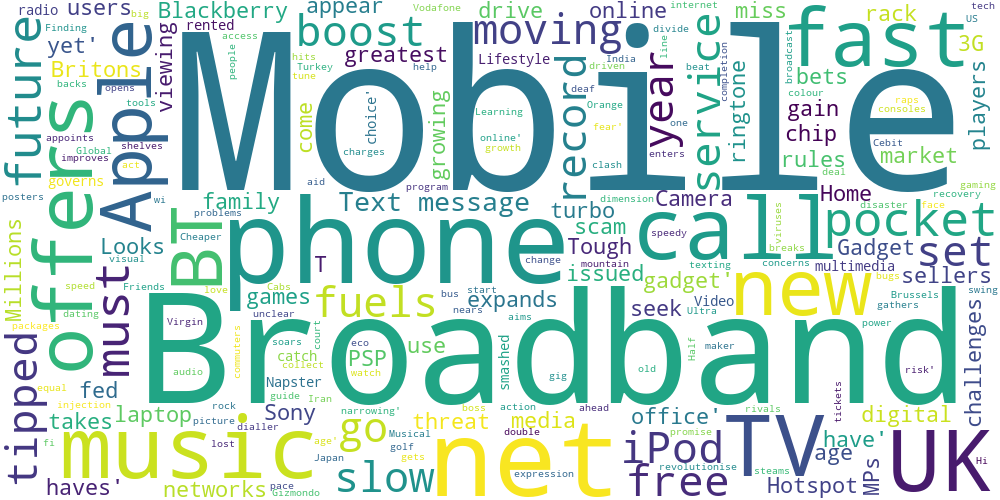

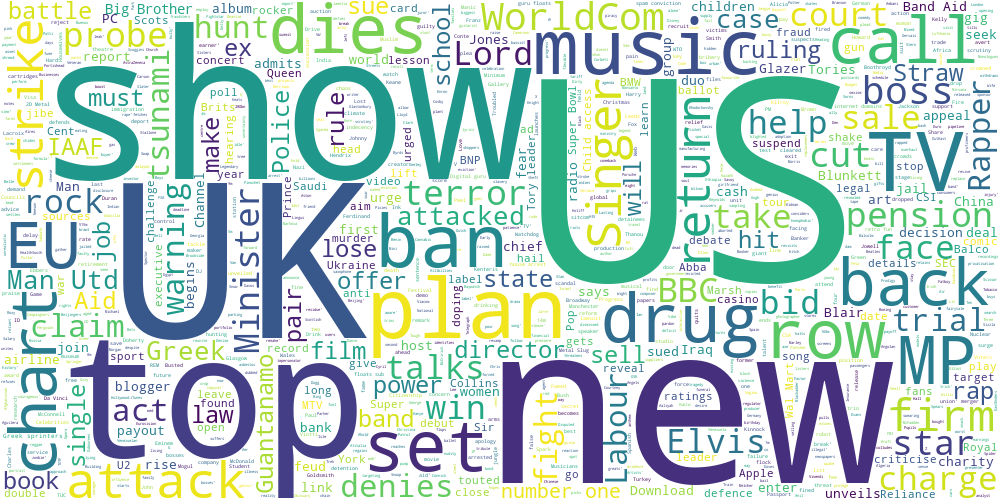

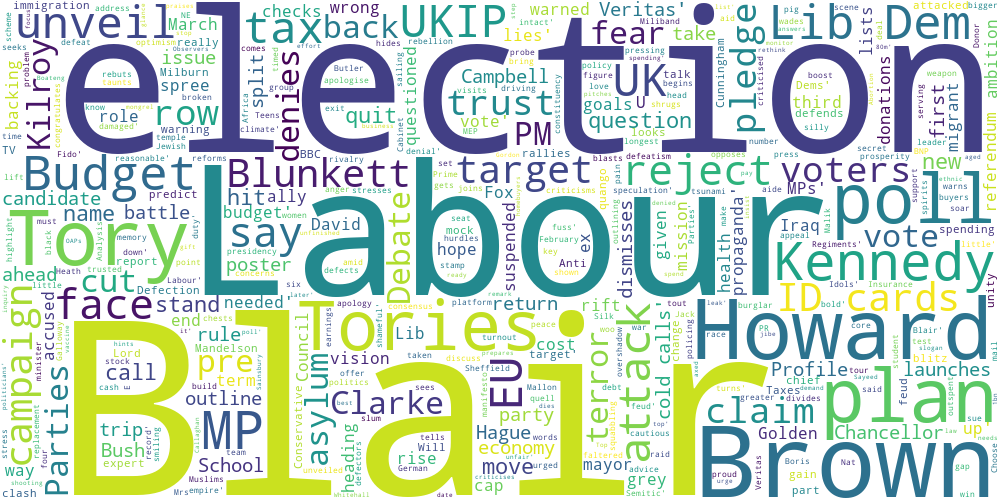

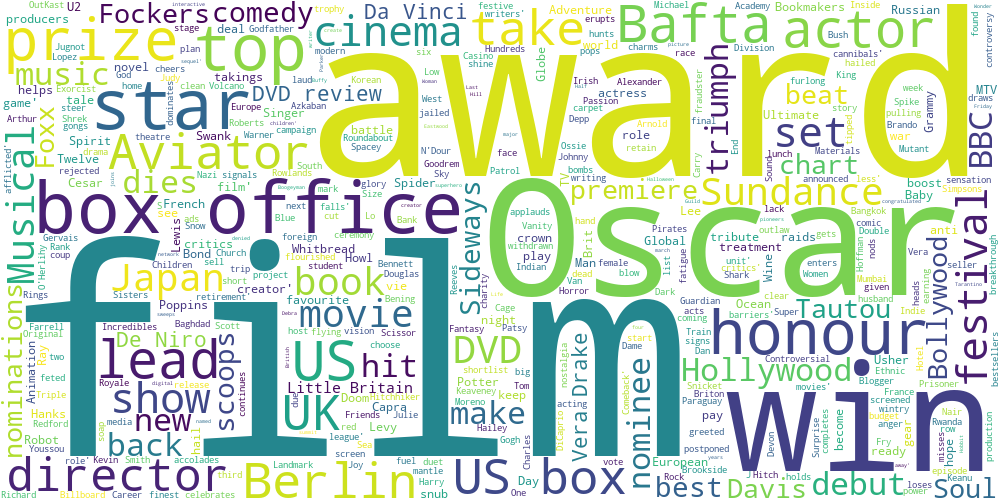

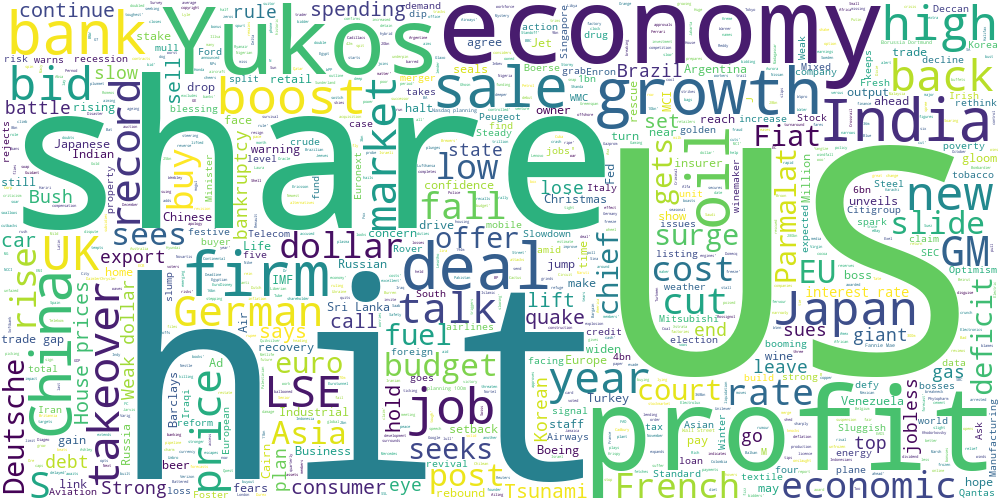

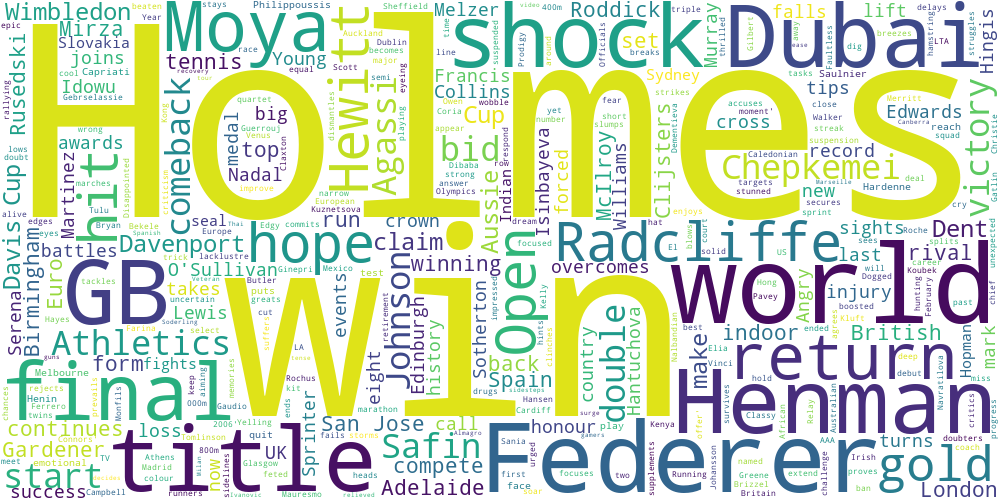

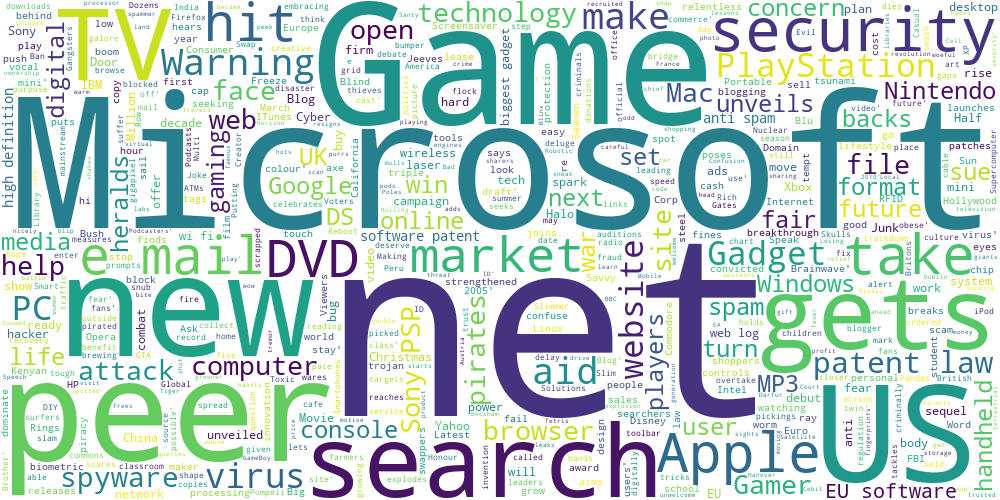

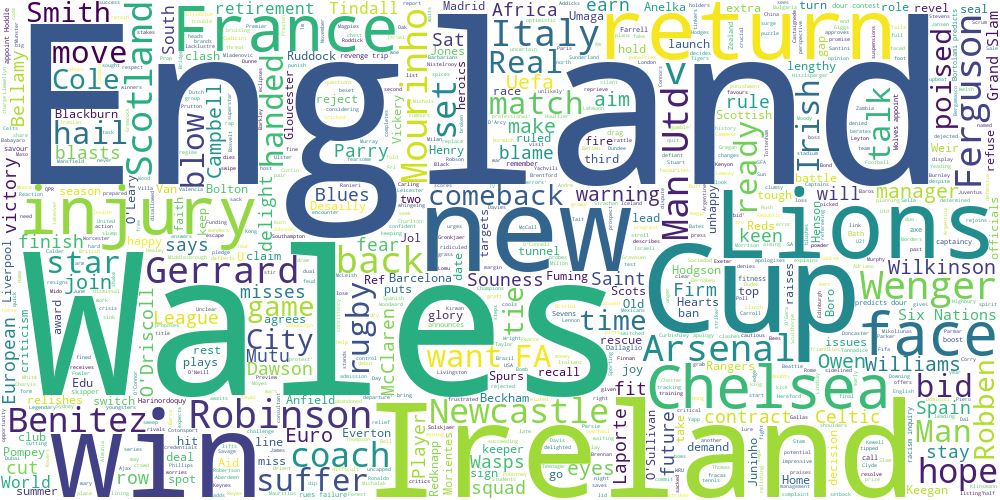

In [15]:
for label in range(n_clusters):
    display(draw_wordcloud(data[labels==label]['title']))

**Задание 1.4 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на несколько слов с наибольшими числовыми значениями. (?) Соответствуют ли полученные слова облакам тегов из прошлого задания?

**Ответ:**
Соответствуют 🗿.

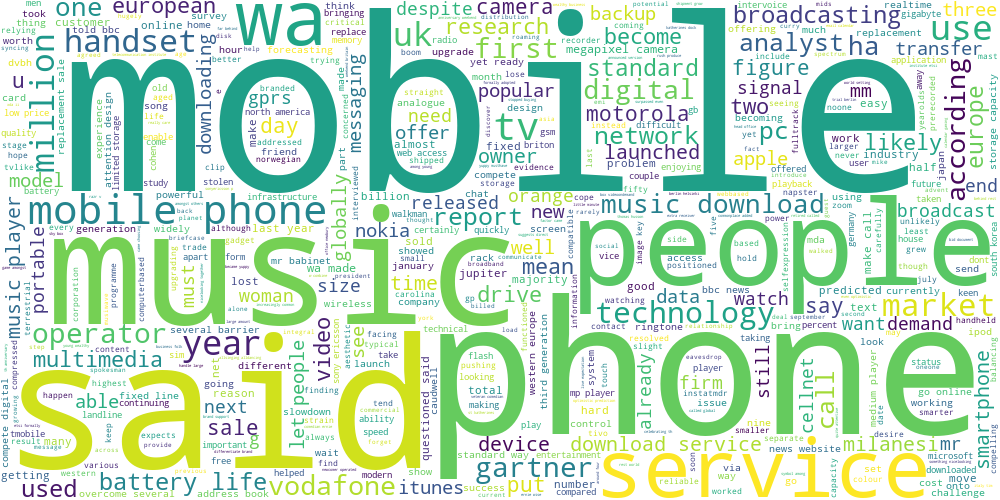

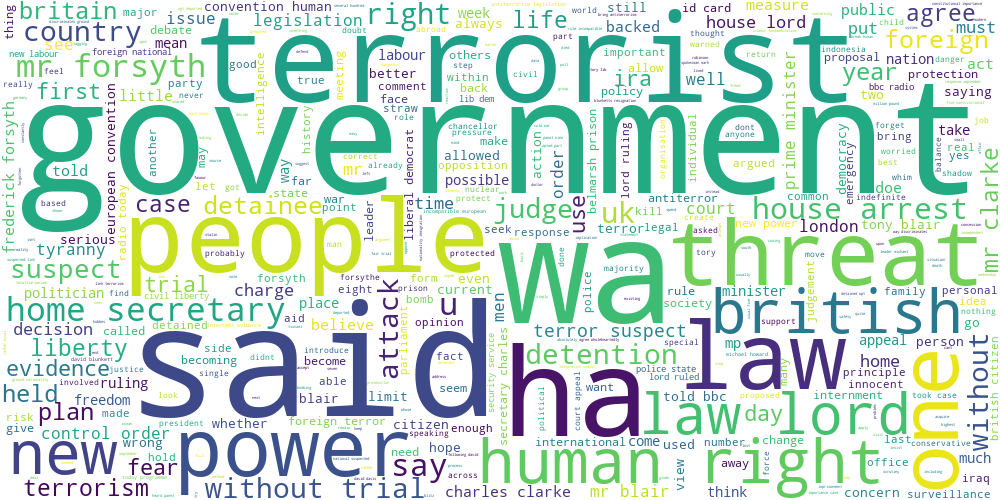

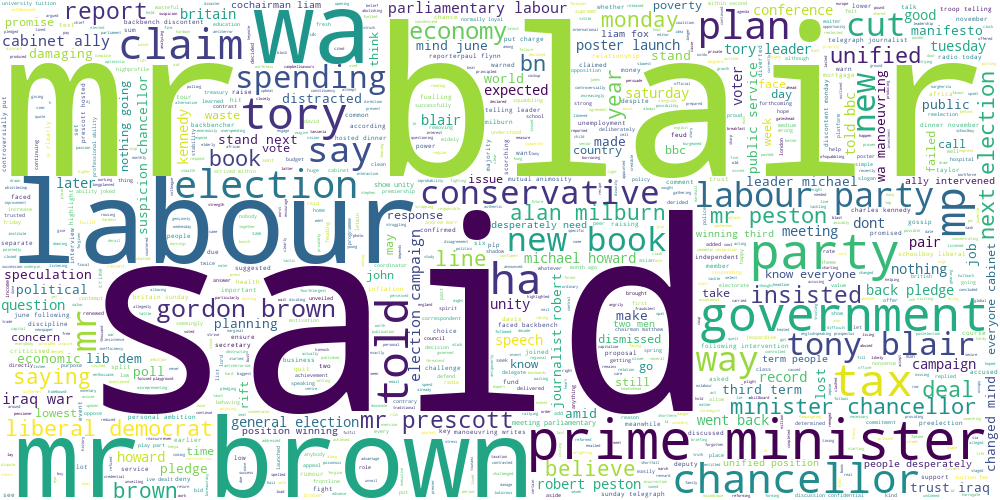

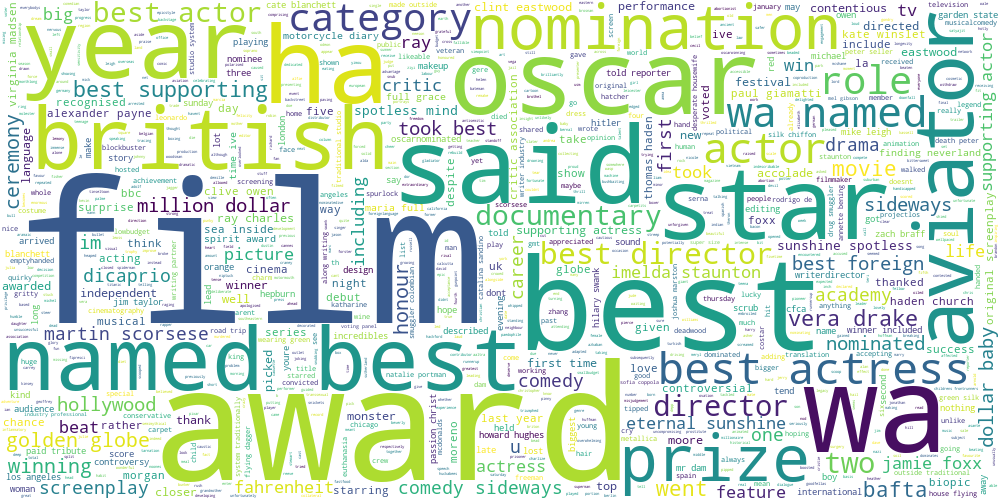

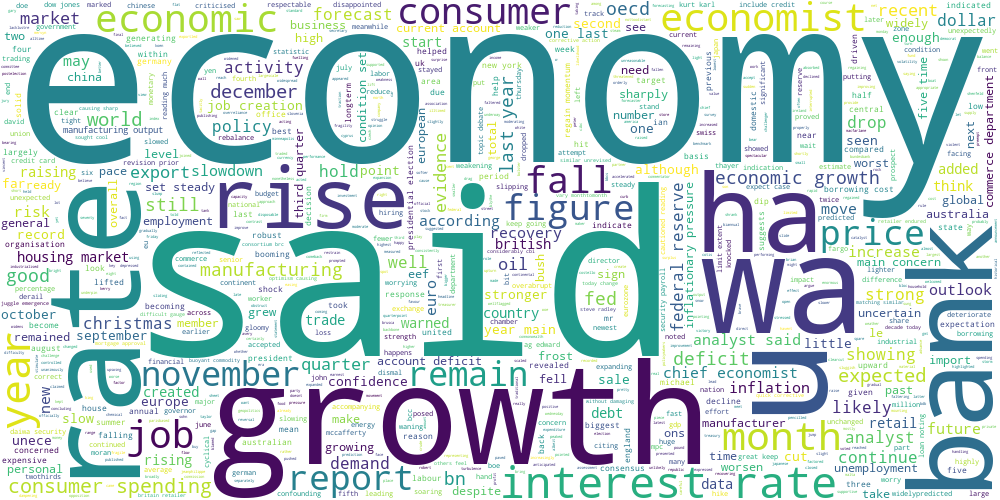

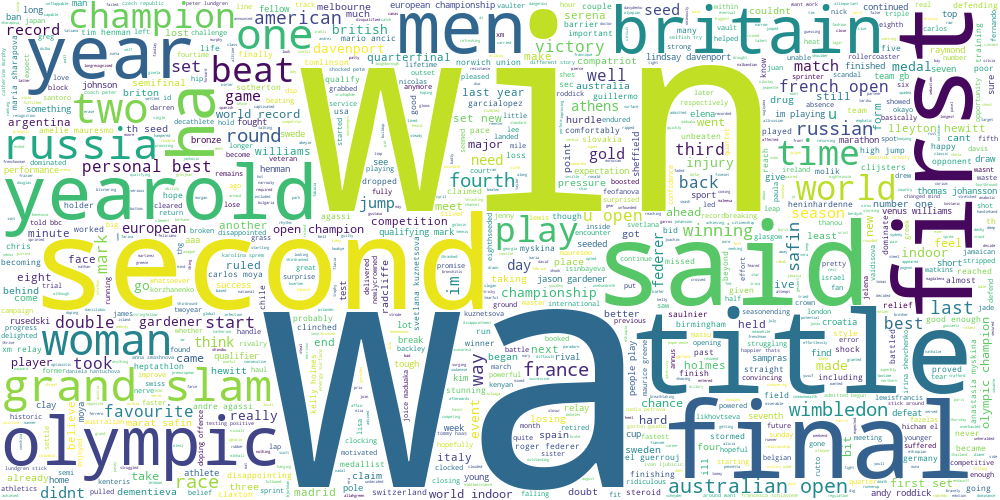

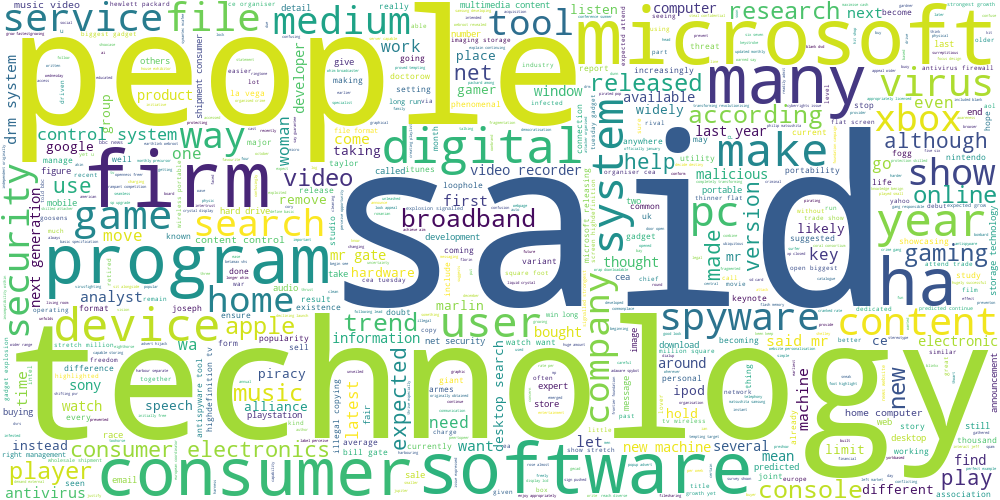

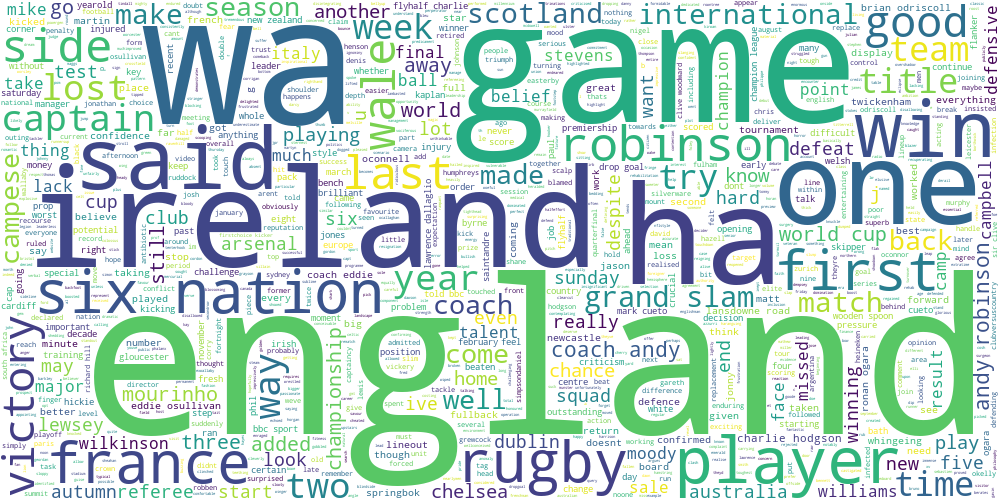

In [16]:
for cluster_center in kmeans.cluster_centers_:
    display(draw_wordcloud(data['text'][np.argsort(np.linalg.norm(X - cluster_center, axis=1))[:10]]))

**Задание 1.5 (можно получить 1.5, 1 или 2.5 баллов)** Попробуем усовершенствовать метод. Реализуйте в приведенном ниже шаблоне ядерный K-means(1.5 баллов) или эллипсоидный метод(1 балл) (можно оба сразу, тогда баллы сложатся). И попробуйте применить его для решаемой задачи. (?)Насколько существенно отличаются  центры кластеров и облака тегов от таковых для предыдущих методов?

Облака слов и центры классов отличаются незначительно, темы просматриваются одинаковые. Однако, сменился порядок, что произошло изз-за случайной инициализации центров кластеров.

In [17]:
from tqdm import tqdm
from scipy.spatial.distance import pdist

In [18]:
class KernelKMeans:
    def __init__(self, n_clusters, iters, kernel):
        """
        KMeans Class constructor.

        Args:
        n_clusters (int) : Number of clusters used for partitioning.
        iters (int) : Number of iterations until the algorithm stops.

        """
        self.k = n_clusters
        self.iters = iters
        self.kernel = kernel
 
    def initialize_clusters(self, X):
        """
        Initialize centroids.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Initial position of centroids
        """
        return X[np.random.choice(range(X.shape[0]), size=self.k), :]

 
    def fit_predict(self, X):
        """
        Implementation of the kernel KMeans algorithm.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Computed centroids
        labels (ndarray): Predicts for each sample in the dataset.
        """
        centroids = self.initialize_clusters(X)
        labels = np.argmin([self.kernel(X, centroid) for centroid in centroids], axis=0)
        for _ in tqdm(range(self.iters)):
            distances = []
            X_to_X = self.kernel(X, X)
            for label in range(self.k):
                c = (labels == label).sum()
                X_to_labeld_X = np.zeros_like(X_to_X)
                
                for i, x in enumerate(X[labels==label]):
                    X_to_labeld_X += self.kernel(X, x)
                    
                labeld_X_to_labeld_X = X_to_labeld_X[labels==label].sum()
                dist = X_to_X - 2 * X_to_labeld_X / c + labeld_X_to_labeld_X / c**2
                distances.append(np.abs(dist))

            labels = np.argmin(np.array(distances).T, axis=1)
        centroids = []
        for i in range(self.k):
            centroids.append(np.mean(X[labels==i], axis=0))
        self.centroids = np.array(centroids)
        return self.centroids, labels

    def get_centroids(self):
        """
        Return the computed centroids
        """
        return self.centroids

In [19]:
def gaus_kernel(x, y):
    return np.exp(-np.linalg.norm(x - y, axis=1)**2 / (2*1))

In [20]:
vectorizer = TfidfVectorizer(min_df=0.01, lowercase=False, max_df = 0.05)
X = vectorizer.fit_transform(data['text'])
X

<2225x2058 sparse matrix of type '<class 'numpy.float64'>'
	with 99941 stored elements in Compressed Sparse Row format>

In [21]:
n_clusters = 8
kernelkmeans = KernelKMeans(n_clusters=n_clusters, iters = 20, kernel = gaus_kernel)
centroids, labels = kernelkmeans.fit_predict(X.toarray())

100%|███████████████████████████████████████████| 20/20 [06:23<00:00, 19.19s/it]


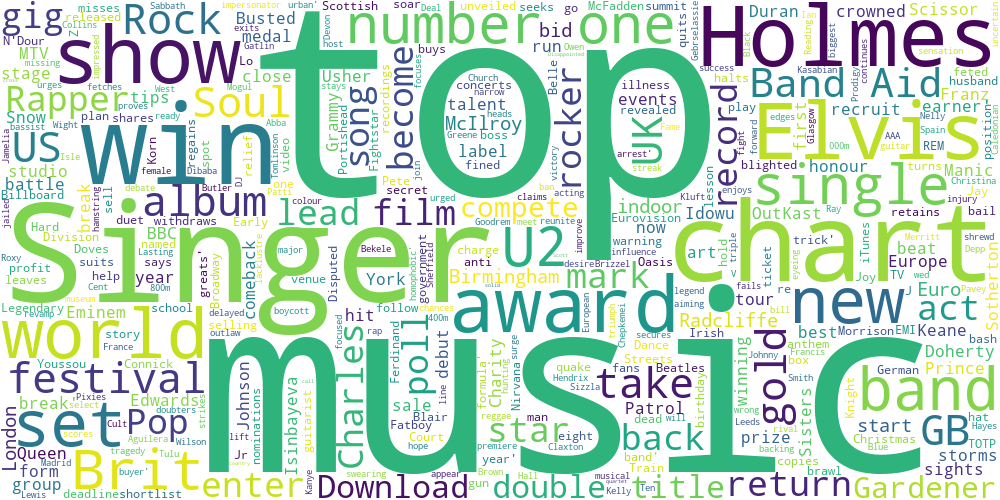

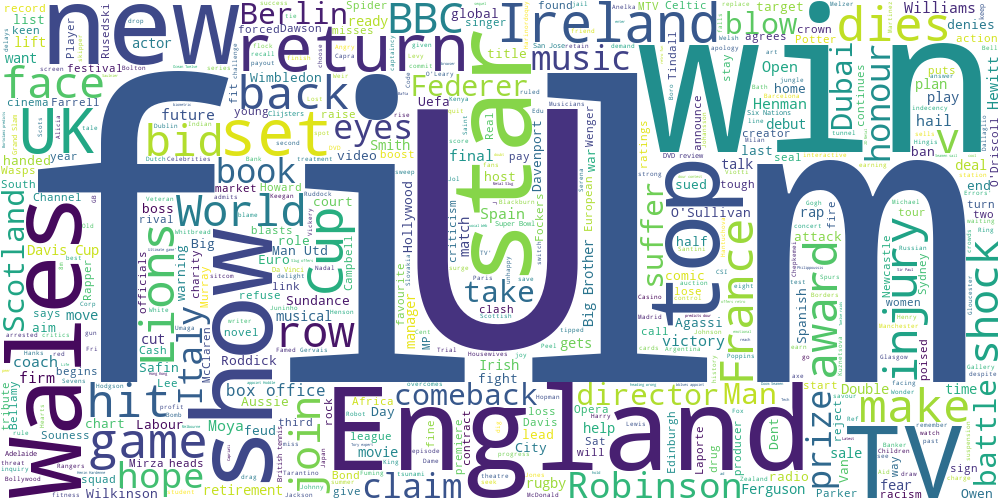

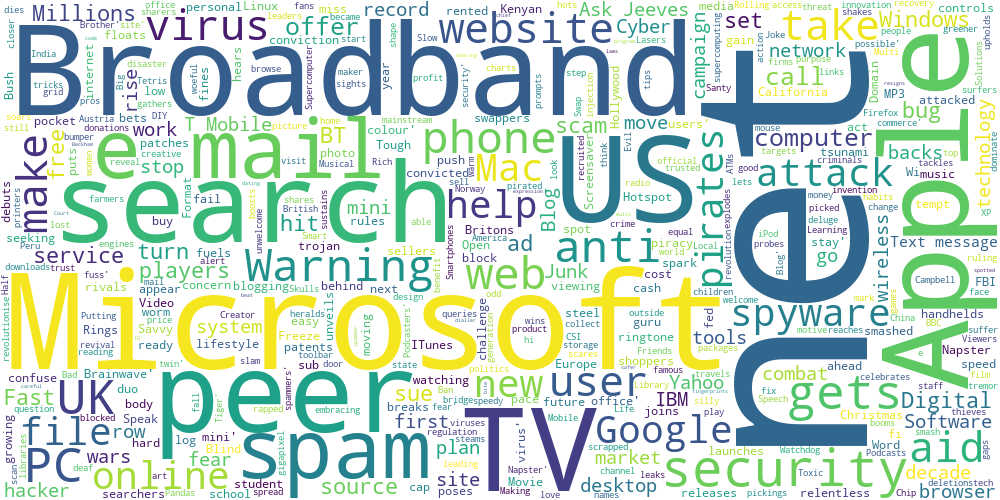

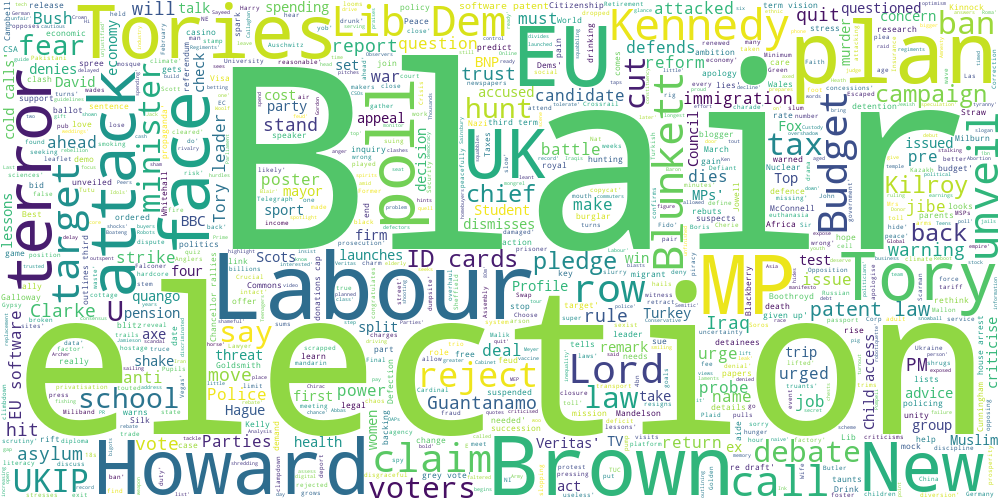

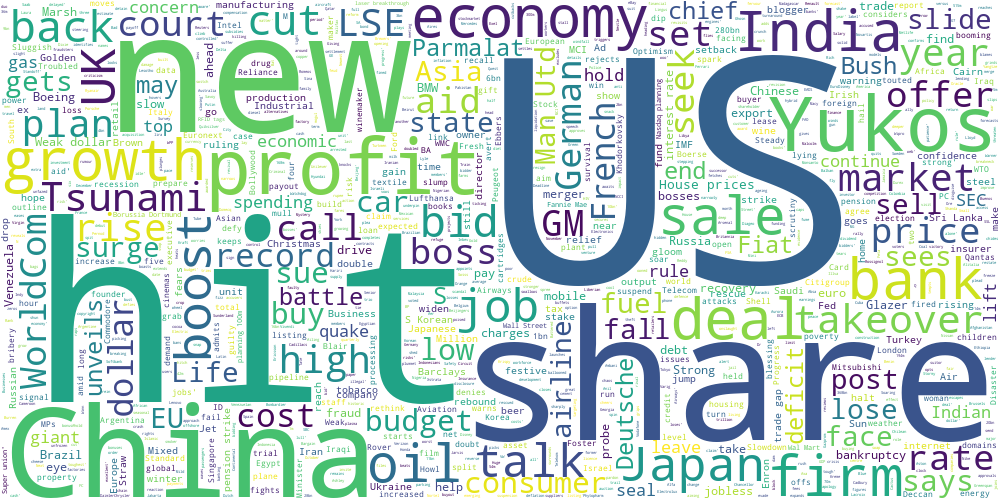

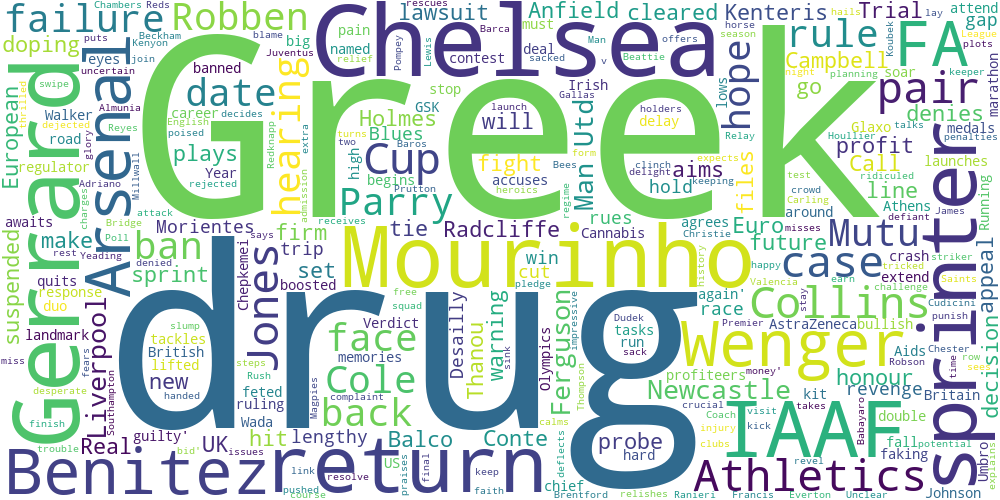

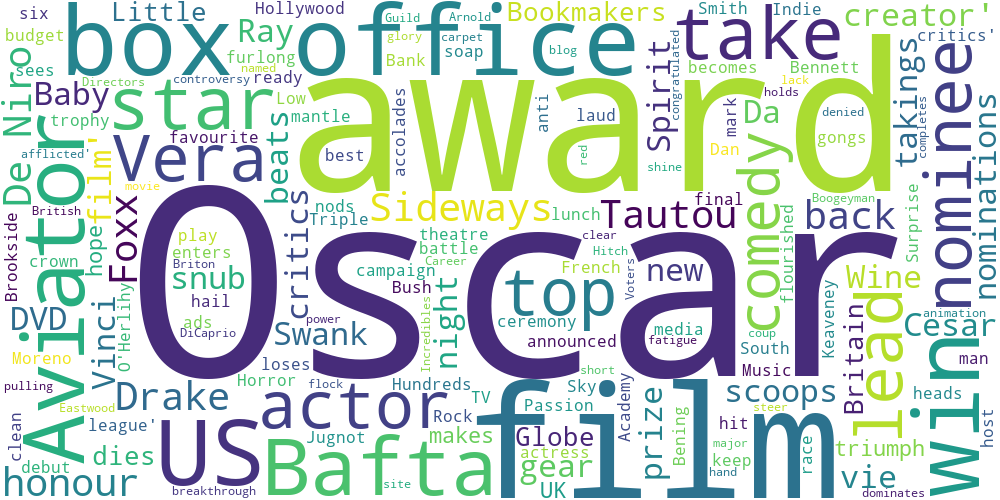

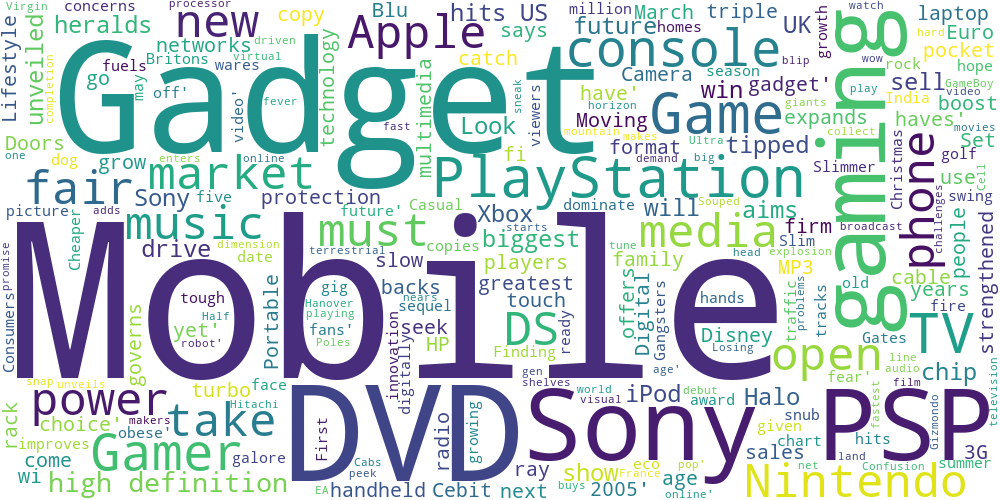

In [22]:
for label in range(n_clusters):
    display(draw_wordcloud(data[labels==label]['title']))

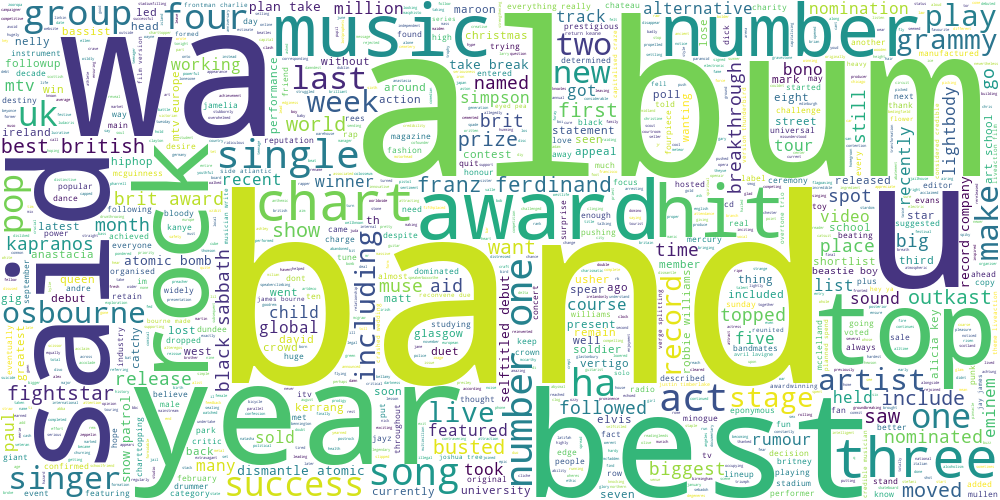

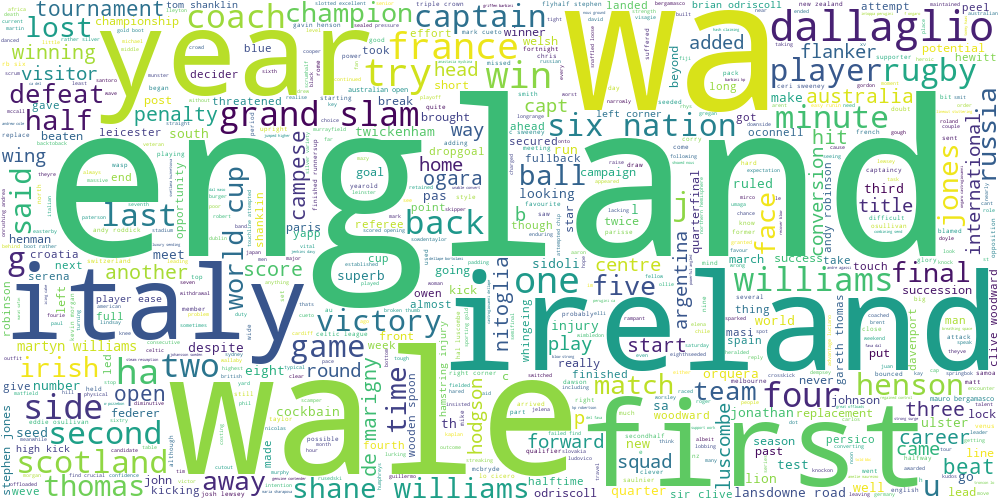

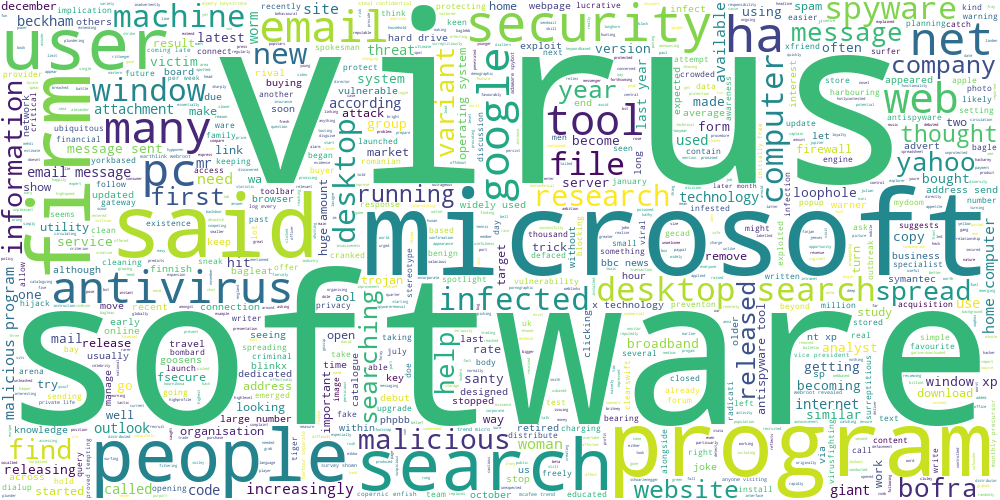

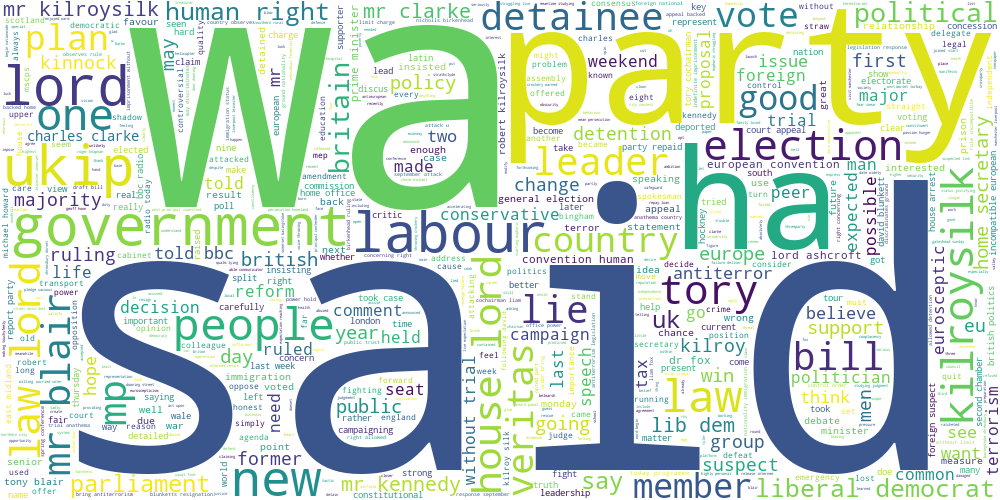

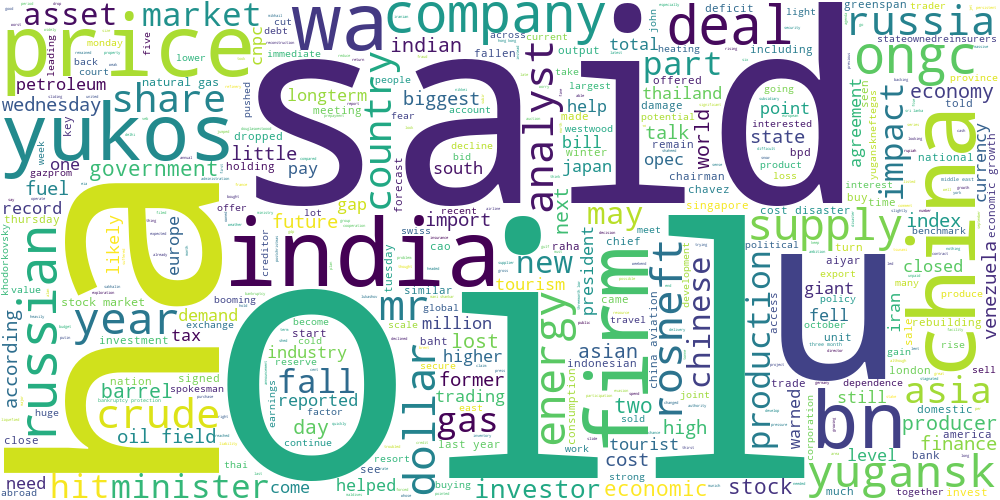

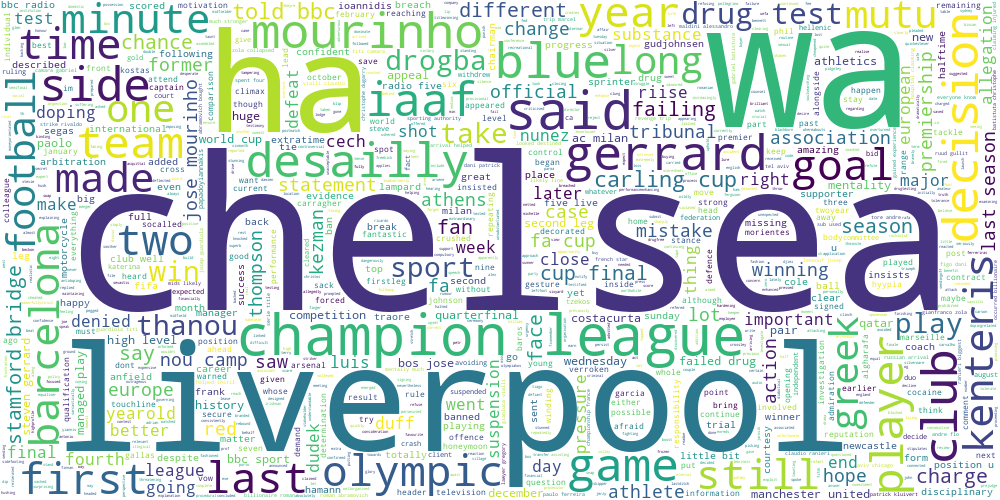

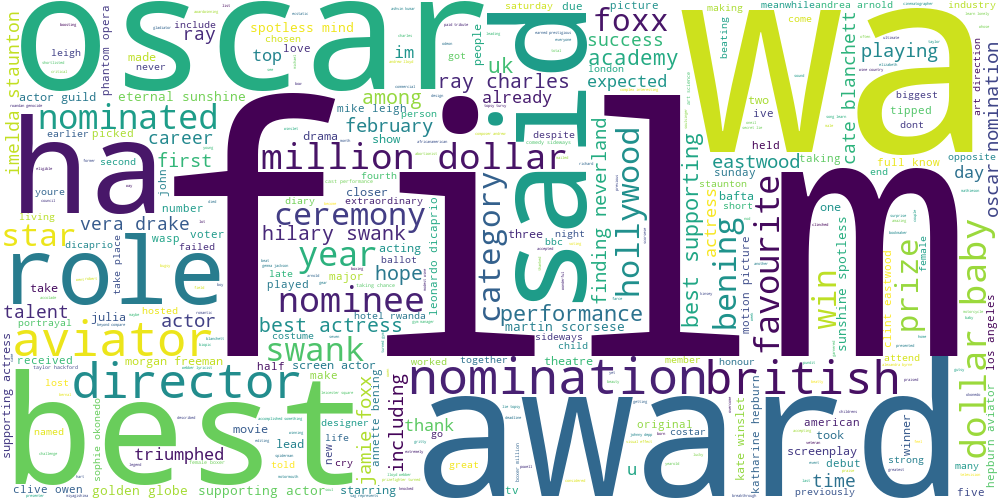

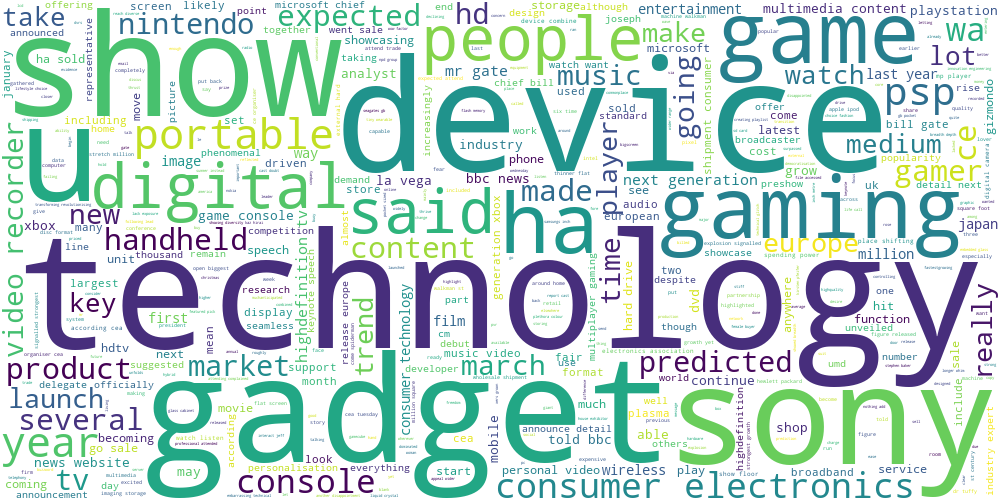

In [23]:
for cluster_center in centroids:
    display(draw_wordcloud(data['text'][np.argsort(np.linalg.norm(X - cluster_center, axis=1))[:10]]))

**Задание 1.6 (0.5 балла).** Теперь попробуем сравнить три разных алгоритма кластеризации. Получите три разбиения на кластеры с помощью алгоритмов K-Means(любого понравившегося), DBSCAN(можно взять готовый из sklearn) и спектральной кластеризации, реализованной вами выше. Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

In [24]:
from sklearn.cluster import DBSCAN

In [25]:
%%time
dbscan_clustering = DBSCAN(eps=1.21).fit(X)
print(np.unique(dbscan_clustering.labels_))

[-1  0  1  2  3  4  5  6]
CPU times: user 9.36 s, sys: 22.8 ms, total: 9.38 s
Wall time: 1.98 s


In [26]:
%%time
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters)
kmeans_labels = kmeans.fit_predict(X)

CPU times: user 224 ms, sys: 38.9 ms, total: 263 ms
Wall time: 117 ms


/Users/nikto/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [27]:
def euclidean_distance(X: np.array, Y: np.array) -> np.array:
    n, m = X.shape[0], Y.shape[0]

    Z = np.dot(X, Y.T)
    X = np.einsum('ij,ij->i', X, X).reshape(n, 1)
    Y = np.einsum('ij,ij->i', Y, Y)

    X = np.repeat(X, repeats=m, axis=1)
    Y = np.tile(Y, (n, 1))

    return (X - 2 * Z + Y) 

In [28]:
%%time
X_array = X.toarray()
pairwise_distances = euclidean_distance(X_array, X_array)
pairwise_distances = np.where(pairwise_distances<0, 0 , pairwise_distances)
graph_clustering = GraphClustering(n_clusters=6)
spectral_labels = graph_clustering.fit_predict(pairwise_distances)

CPU times: user 5.91 s, sys: 545 ms, total: 6.45 s
Wall time: 1.59 s


/Users/nikto/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


(?) Теперь постройте облака слов и снова проинтерпретируйте темы. 

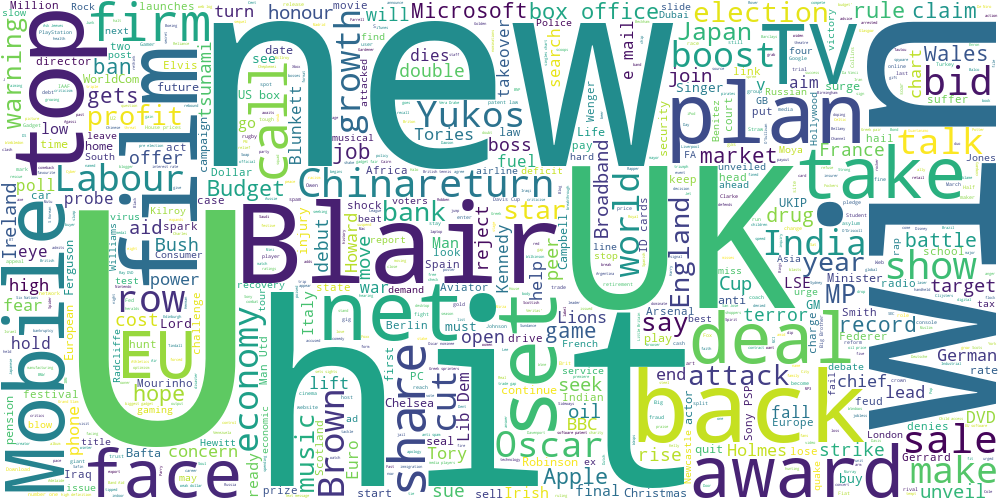

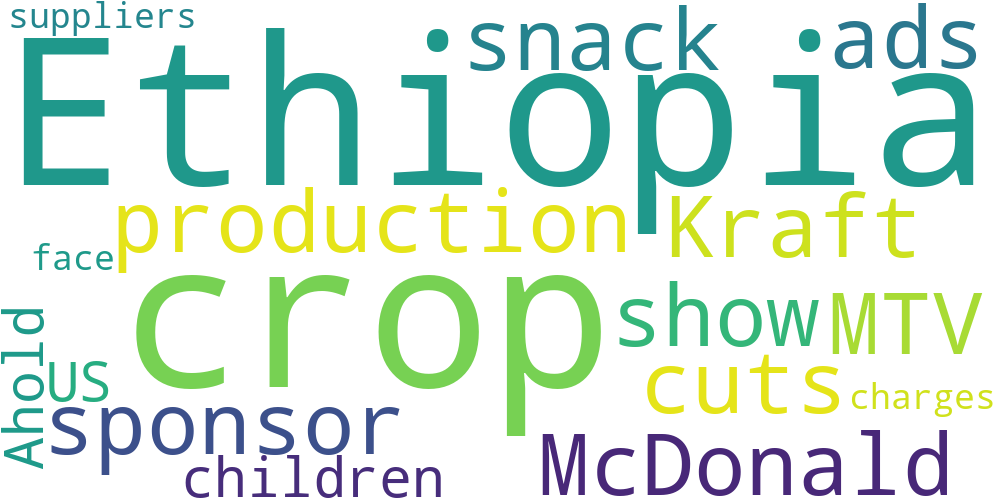

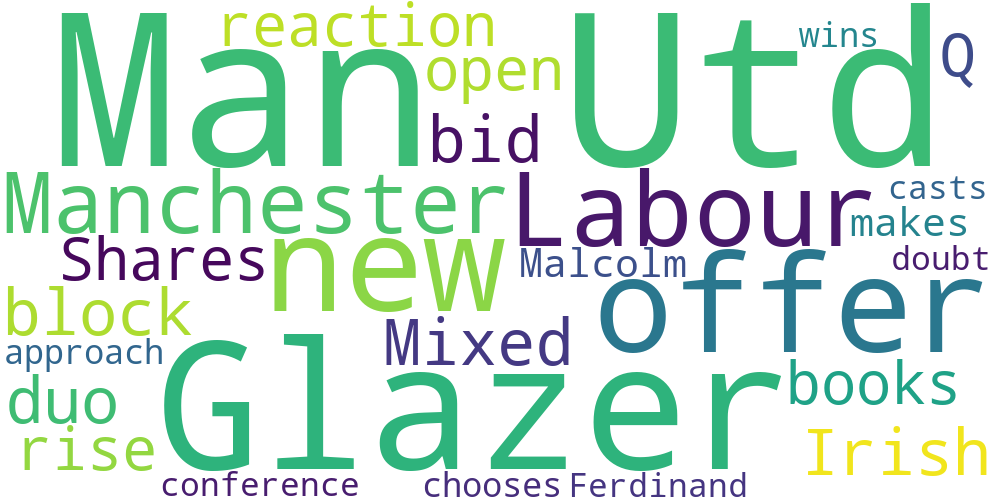

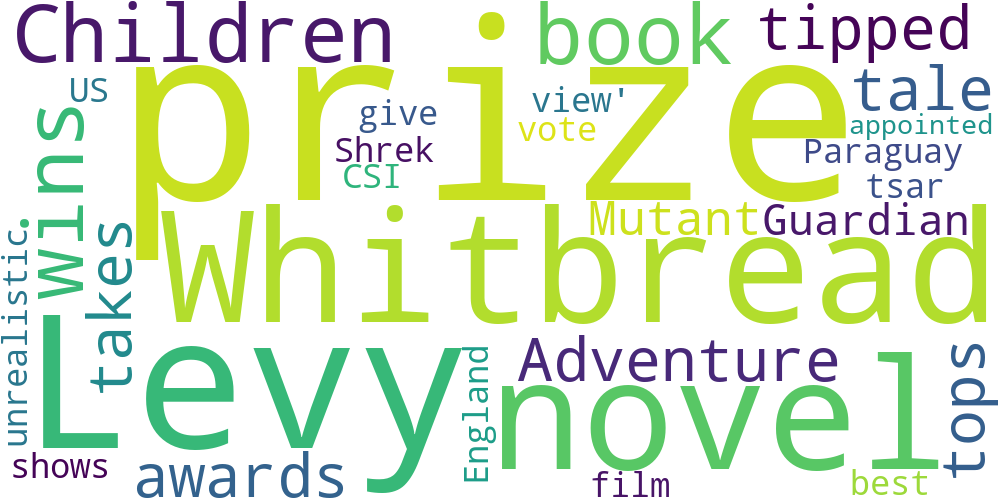

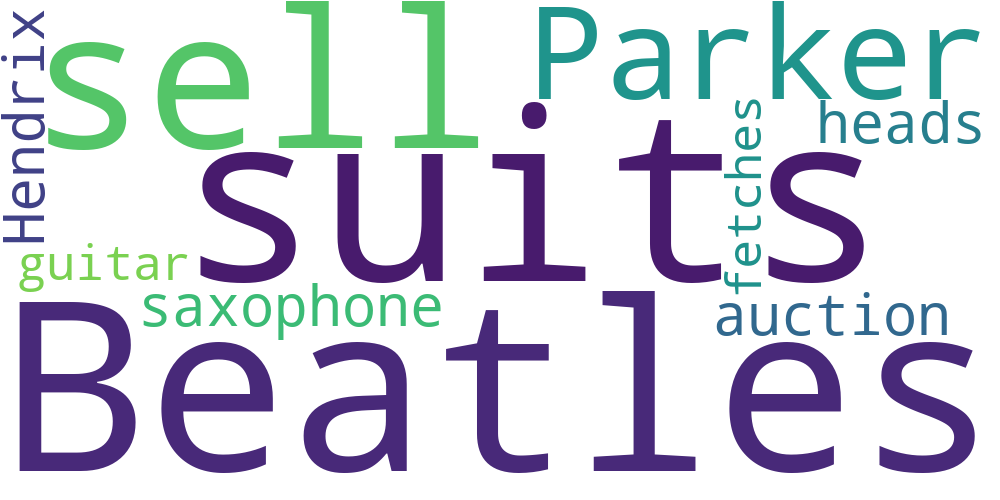

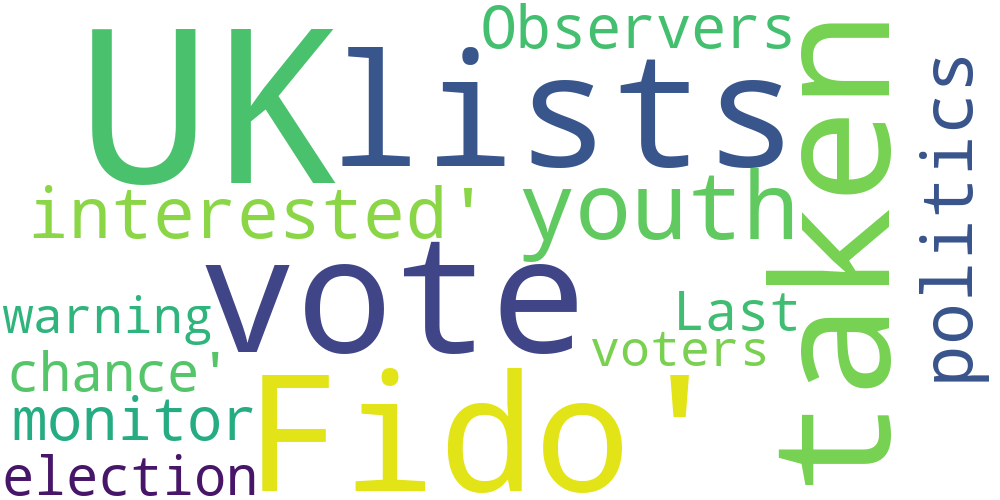

In [29]:
for label in range(n_clusters):
    display(draw_wordcloud(data[dbscan_clustering.labels_==label]['title']))

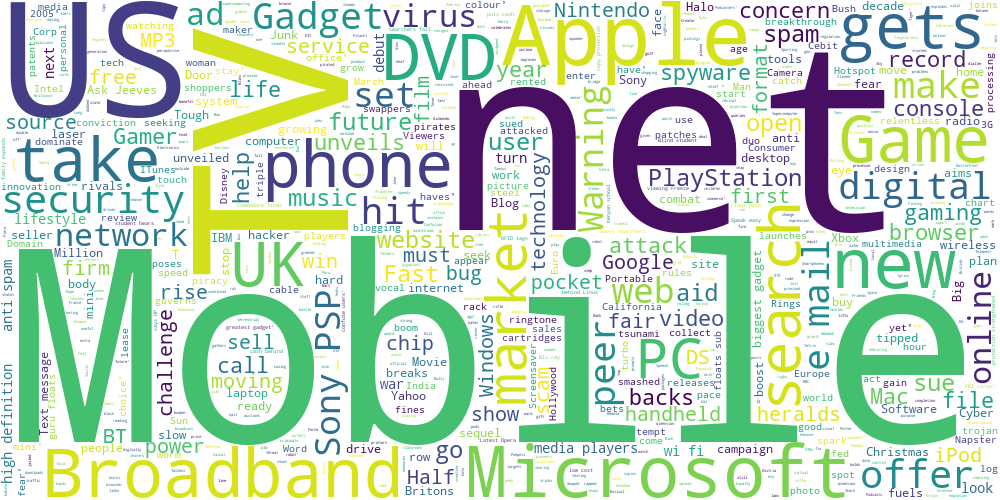

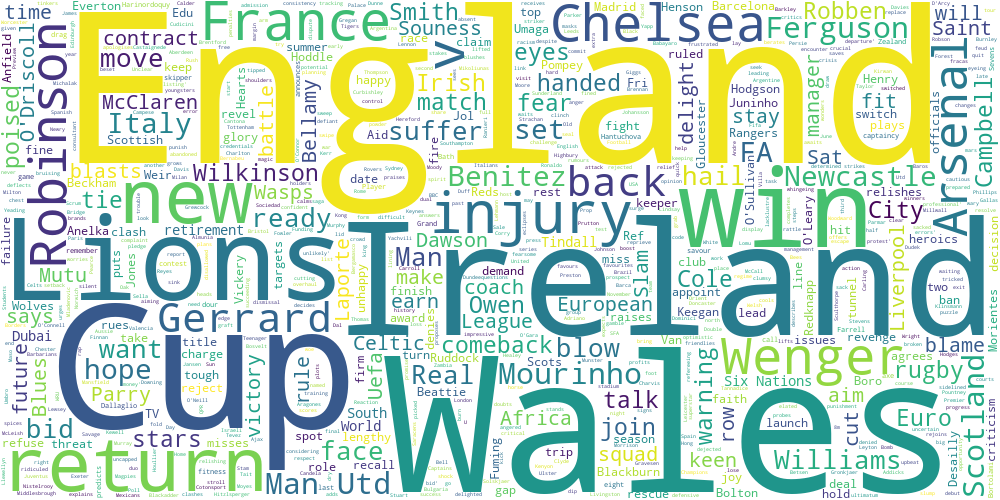

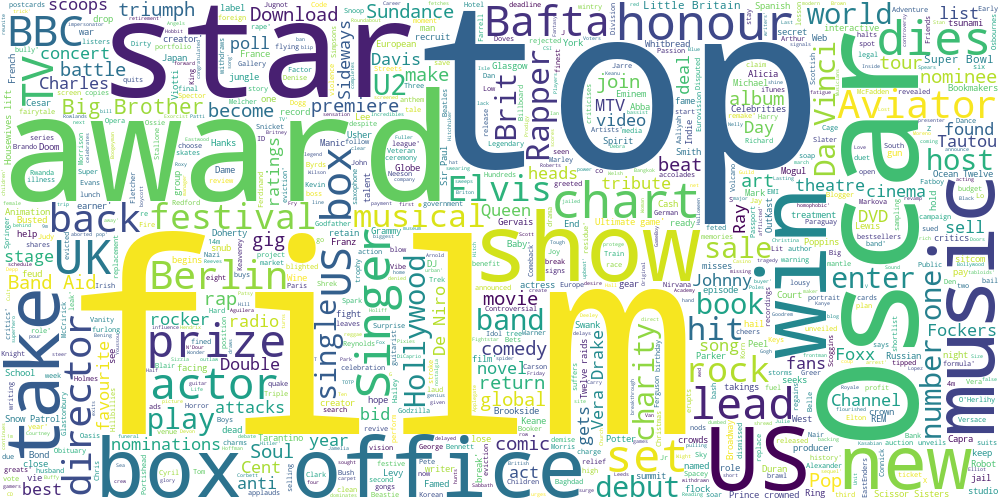

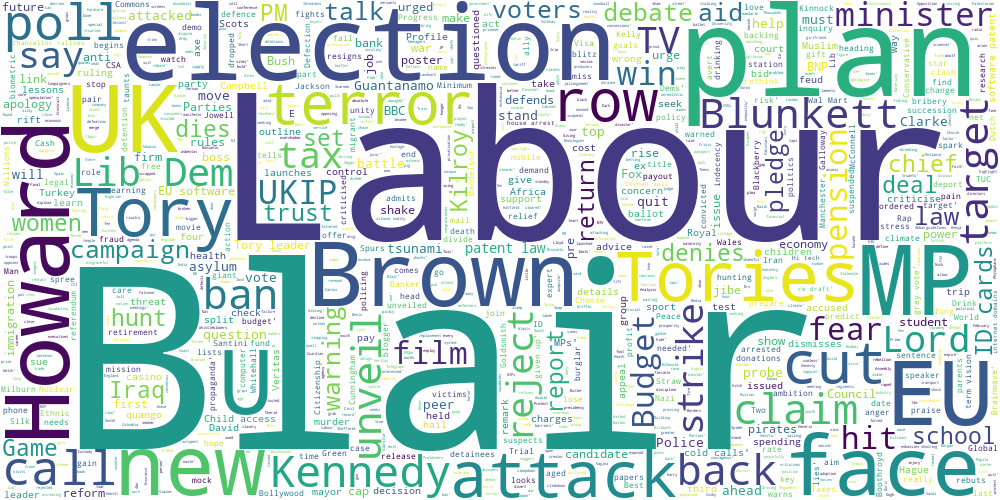

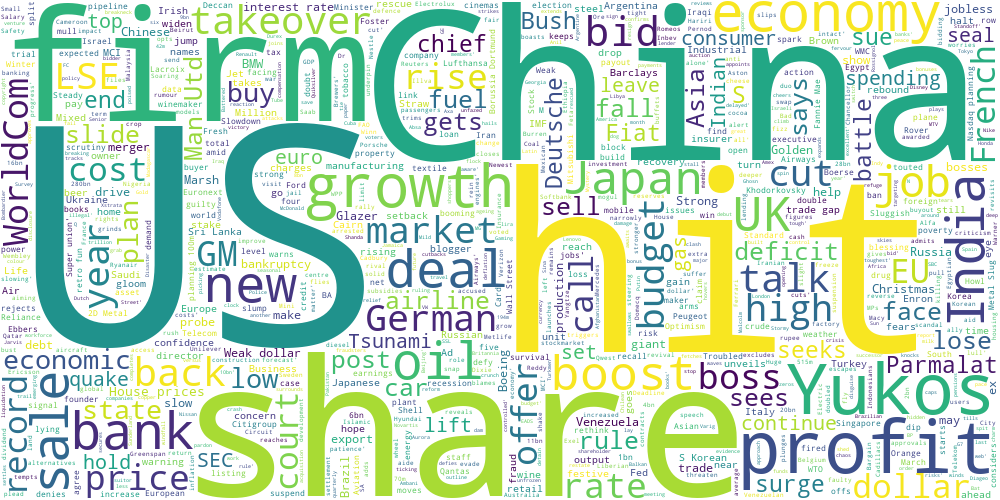

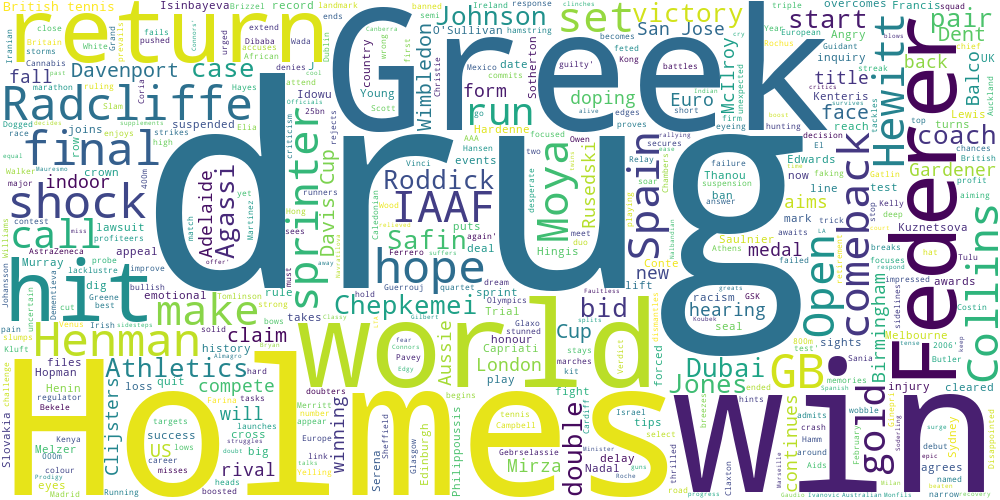

In [30]:
for label in range(n_clusters):
    display(draw_wordcloud(data[kmeans_labels==label]['title']))

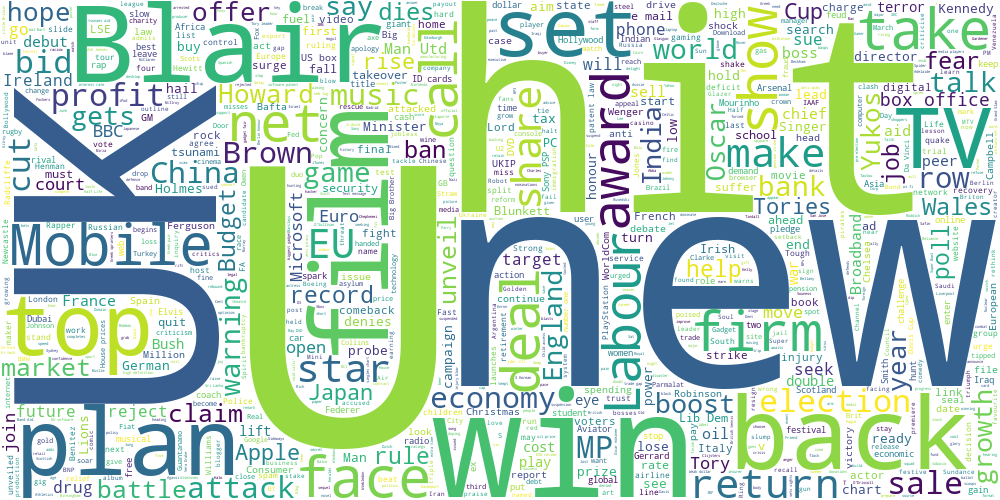

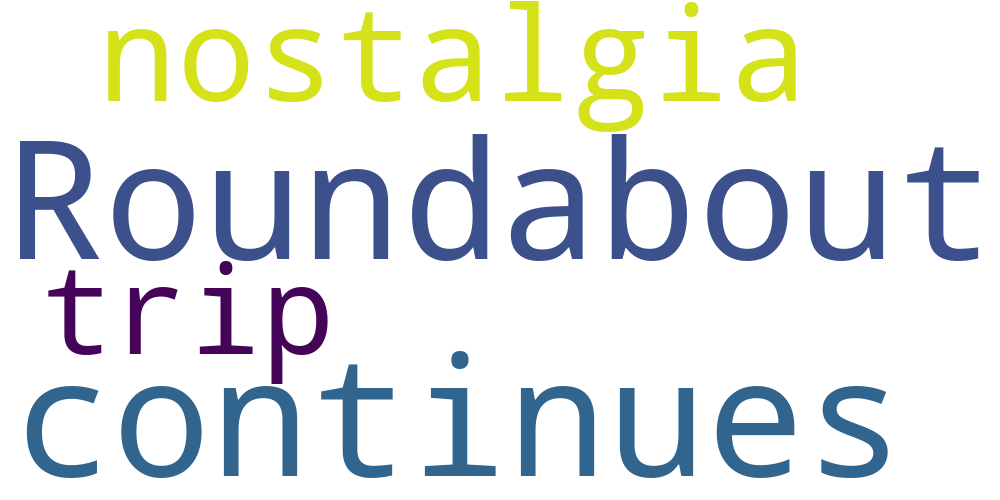

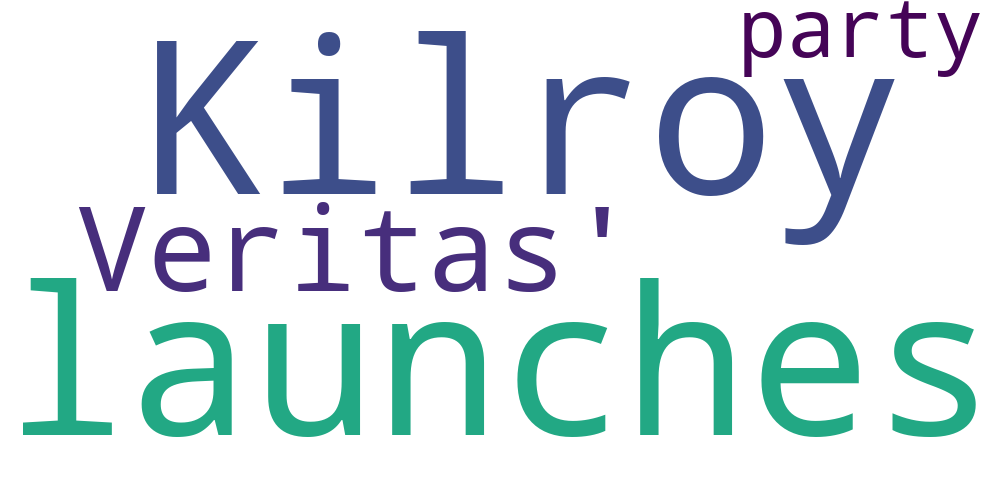

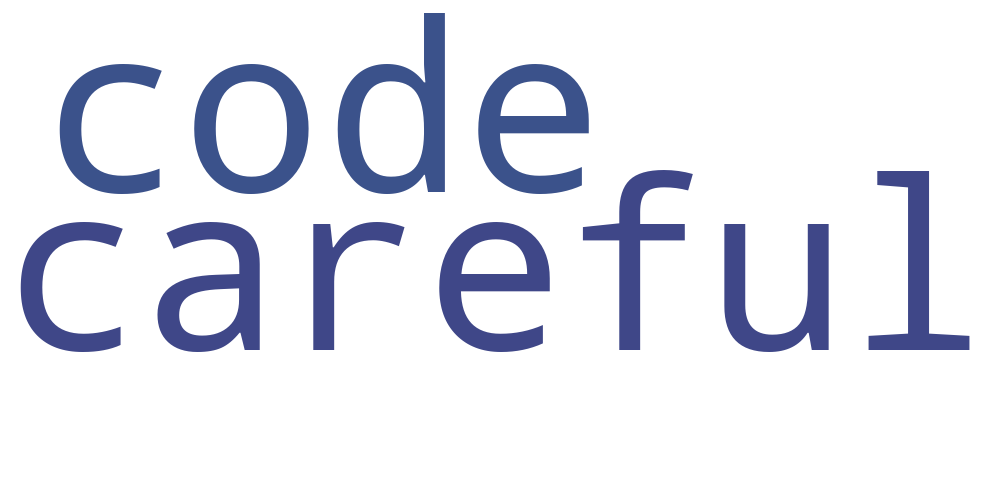

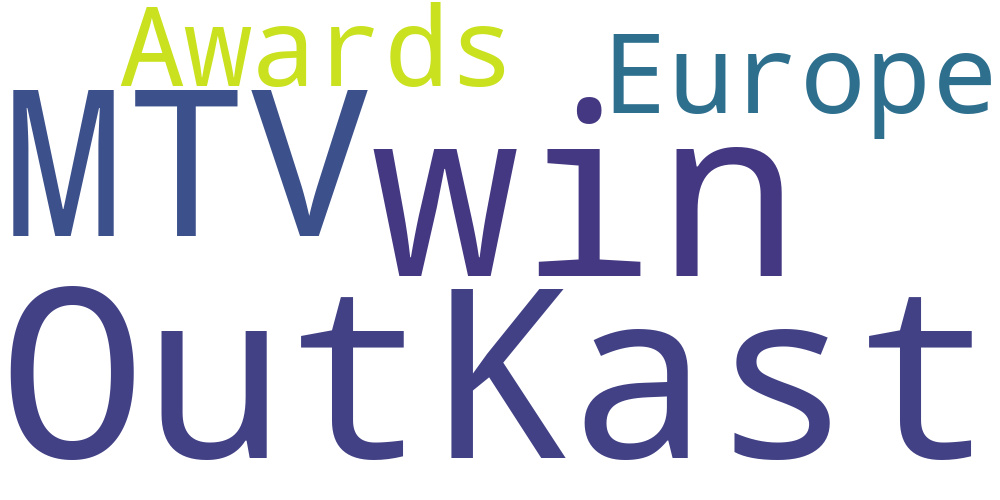

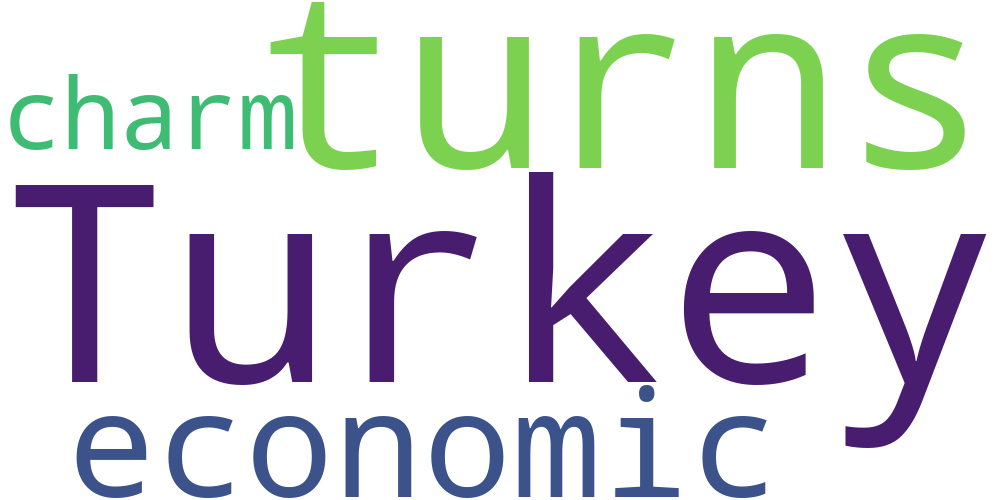

In [31]:
for label in range(n_clusters):
    display(draw_wordcloud(data[spectral_labels==label]['title']))

Сравнивая методы кластеризации можно заметить, что:
- kmeans осбирает большее число слов в темы, когда dbscan и спектральная кластеризация более выражено отбирают "ключевые слова"
- самым интерпретируемым в данной задаче, на мой взгляд, кажется kmeans
- среди основных тем можно выделить: киниматограф, политику, экономику, технологии, часть тем отдельно выделяет некоторые страны (UK, England, Ireland)

**Задание 1.6 (1 балл).** Также, для анализа качества кластеризации иногда бывает полезно "посмотреть" накластеры. Обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [32]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

X_embedded = TSNE(n_components=2, learning_rate='auto',
                  init='random', perplexity=3).fit_transform(X)


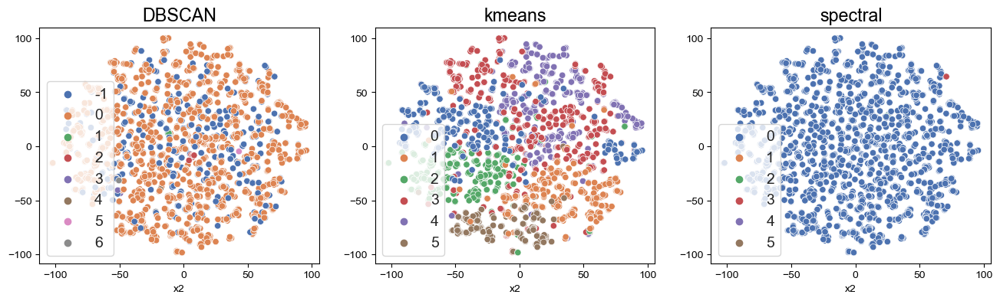

In [33]:
titles = ['DBSCAN','kmeans', 'spectral']
figure, axis = plt.subplots(1, 3, figsize=(16, 4))
plt.rcParams.update({'font.size': 14})
sns.set_style('whitegrid')
for i in range(3):
    axis[i].set_xlabel('x1')
    axis[i].set_xlabel('x2')
    axis[i].set_title(titles[i])
sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=dbscan_clustering.labels_,  palette="deep", ax = axis[0])
sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=kmeans_labels,  palette="deep", ax = axis[1])
sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=spectral_labels,  palette="deep", ax = axis[2])

plt.show()

(?) Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Сделаете выводы о каждом исследованном в части 1 алгоритме и их применимости к задаче тематического моделирования. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:**
- dbscan и спектральная кластеризация показывают схожую картину - выделение одного больщого кластера. На остальные же кластеры приходится малое число объектов. Кажется, что "нулевой" класс не несет в себе информации и требует более детального разбиения. Можно сделать вывод, что оба алгоритма не смогли выделить необходимые закономерности. Возможно, необходимо изменять параметры.
- kmeans показывает визуально неплохую кластеризацию, на картинке видно 6 основных кластеров, элементов в каждом из кластеров сравнимое число. Интерпритация у kmeans по облакам слов получилась лучше.
- по вычислительной сложности на dbscan ушло 1.98 секунд, на kmeans 117мс и на спектральную кластеризацию 1.59 секунды ри размере обучающей выборки $2225 \times 2058$. Ядерный kmeans в силу своей неоптимальной реализации сравнивать не будем.
- отдельно для спектрального разложения необходимо формировать матрицу размерноть признакого пространства $\times$ размерноть признакого пространства, что даже в дайнной задаче потребовало понижения размерности признакового пространства, в ином случае подсчет собственных векторов и значений занимает ощутимо большее время. 

## Часть 2. Transfer learning для задачи классификации текстов.

**Задание 3.1 (4 балла).** Вспомним, что у нас есть разметка для тематик статей. Просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 1:13:6. 70% выборки будем использовать для обучения, а остальные 30% для валидации

Обучите метрику Махаланобиса любыми **тремя**  методами (отсюда)[http://contrib.scikit-learn.org/metric-learn/supervised.html] только на маленьком куске (5%) обучающей выборки. Кластеризуйте данные методом k-means с обученными метриками  и проанализирйте полученные результаты. 

Сравните 3 подхода к класификации:

Логистическая регрессия на tf-idf признаках

K-Means с евклидовой метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

K-Means с обученной метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всей обучающей выборке целиком (70%), а итоговый классификатор и обучение метрики обучайте только на ее маленьком куске (5%). Подберите гиперпараметры моделей по качеству на валидационной выборке (30%), а затем оцените качество на тестовой выборке (не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации).

**В качестве метрики качества используйте accuracy**

Можете провести дополнительные исследования с другими методами кластеризации и получить более высокое качество. За качественные исследования с хорошим описанием можно получить **до 2 бонусных баллов**.

In [34]:
from sklearn.model_selection import train_test_split
from metric_learn import NCA, LFDA, MLKR

In [35]:
class CustomKMeans:
    def __init__(self, n_clusters, iters, V):
        """
        KMeans Class constructor.

        Args:
        n_clusters (int) : Number of clusters used for partitioning.
        iters (int) : Number of iterations until the algorithm stops.
        V (ndarray) : Mahalanobis matrix learned by the metric learner
        """
        self.k = n_clusters
        self.iters = iters
        self.V = V
 
    def initialize_clusters(self, X):
        """
        Initialize centroids.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Initial position of centroids
        """
        return X[np.random.choice(range(X.shape[0]), size=self.k), :]

 
    def fit_predict(self, X):
        """
        Implementation of the kernel KMeans algorithm.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Computed centroids
        labels (ndarray): Predicts for each sample in the dataset.
        """
        centroids = self.initialize_clusters(X)

        for _ in tqdm(range(self.iters)):
            labels = np.argmin([np.diag((X - centroid) @ self.V @ (X - centroid).T) for centroid in centroids], axis=0)
            for label in range(self.k):
                centroids[label] = np.mean(X[labels==label], axis=0)
                
        self.centroids = centroids
        return centroids, labels

    def get_distance_to_centroids(self, X):
        return np.array([np.diag((X - centroid) @ self.V @ (X - centroid).T) for centroid in self.centroids]).T

In [36]:
X_train, X_test, data_train, data_test, y_train, y_test = train_test_split(X, data, y, train_size=0.8, random_state=0)
X_train, X_valid, data_train, data_valid, y_train, y_valid = train_test_split(X_train, data_train, y_train, train_size=0.7, random_state=0)
X_train, X_labeled, data_train, data_labeled, y_train, y_labeled = train_test_split(X_train, data_train, y_train, train_size=0.92, random_state=0)
print(X_train.shape, X_valid.shape, X_labeled.shape)
print(data_train.shape, data_valid.shape, data_labeled.shape)
print(y_train.shape, y_valid.shape, y_labeled.shape)

(1146, 2058) (534, 2058) (100, 2058)
(1146, 5) (534, 5) (100, 5)
(1146,) (534,) (100,)


In [37]:
%%time
nca = NCA(random_state=0)
nca.fit(X_labeled.toarray(), y_labeled)

CPU times: user 6.62 s, sys: 732 ms, total: 7.35 s
Wall time: 4.79 s


NCA(random_state=0)

In [38]:
%%time

lfda = LFDA()
lfda.fit(X_labeled.toarray(), y_labeled)

/Users/nikto/miniconda3/lib/python3.10/site-packages/scipy/sparse/linalg/_eigen/arpack/arpack.py:1600: RuntimeWarning: k >= N for N * N square matrix. Attempting to use scipy.linalg.eigh instead.
  warnings.warn("k >= N for N * N square matrix. "


CPU times: user 14.2 s, sys: 329 ms, total: 14.5 s
Wall time: 12.2 s


/Users/nikto/miniconda3/lib/python3.10/site-packages/metric_learn/lfda.py:148: RuntimeWarning: invalid value encountered in multiply
  vecs *= np.sqrt(vals)


LFDA()

In [39]:
%%time

mlkr = MLKR()
mlkr.fit(X_labeled.toarray(), y_labeled)

CPU times: user 23.1 s, sys: 2.01 s, total: 25.1 s
Wall time: 12.9 s


MLKR()

In [40]:
n_clusters = 6
nca_kmeans = CustomKMeans(n_clusters=n_clusters, V = nca.get_mahalanobis_matrix(), iters=50)
nca_labels = nca_kmeans.fit_predict(X_train.toarray())

100%|███████████████████████████████████████████| 50/50 [00:38<00:00,  1.29it/s]


In [53]:
lfda_kmeans = CustomKMeans(n_clusters=n_clusters, V = lfda.get_mahalanobis_matrix(), iters=50)
lfda_labels = lfda_kmeans.fit_predict(X_train.toarray())

100%|███████████████████████████████████████████| 50/50 [03:19<00:00,  3.99s/it]


In [42]:
mlkr_kmeans = CustomKMeans(n_clusters=n_clusters, V = mlkr.get_mahalanobis_matrix(), iters=50)
mlkr_labels = mlkr_kmeans.fit_predict(X_train.toarray())

100%|███████████████████████████████████████████| 50/50 [00:38<00:00,  1.29it/s]


In [43]:
X_train_embedded = TSNE(n_components=2, learning_rate='auto',
                      init='random', perplexity=3).fit_transform(X_train)

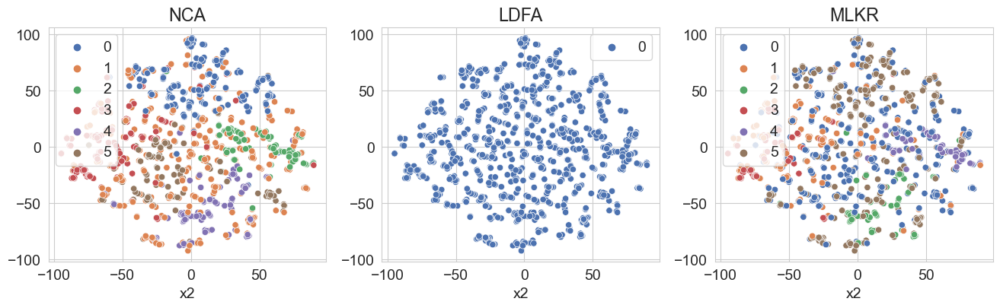

In [54]:
titles = ['NCA','LDFA', 'MLKR']
figure, axis = plt.subplots(1, 3, figsize=(16, 4))
plt.rcParams.update({'font.size': 14})
sns.set_style('whitegrid')
for i in range(3):
    axis[i].set_xlabel('x1')
    axis[i].set_xlabel('x2')
    axis[i].set_title(titles[i])
sns.scatterplot(x=X_train_embedded[:, 0], y=X_train_embedded[:, 1], hue=nca_labels[1],  palette="deep", ax = axis[0])
sns.scatterplot(x=X_train_embedded[:, 0], y=X_train_embedded[:, 1], hue=lfda_labels[1],  palette="deep", ax = axis[1])
sns.scatterplot(x=X_train_embedded[:, 0], y=X_train_embedded[:, 1], hue=mlkr_labels[1],  palette="deep", ax = axis[2])


plt.show()

Что-то LDFA приуныл. \
Видно, что более "хорошее?" распеределение по классам показывает NCA. Будем использовать его.

# Перейдем к классификации

In [45]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

In [46]:
def search_log(X_train, y_train, X_valid, y_valid):
    best_estimator = None
    best_acc = 0
    for penalty in ["l1", "l2", "elasticnet"]:
        for c in [10, 100, 1000, 10e3, 10e4]:
            if penalty == "elasticnet":
                logreg = LogisticRegression(penalty=penalty, l1_ratio=0.60, C=c, solver='saga', tol=10e-3).fit(X_train, y_train)
            else:
                logreg = LogisticRegression(penalty=penalty, C=c, solver='saga', tol=10e-3).fit(X_train, y_train)
            
            acc = (logreg.predict(X_valid) == y_valid).sum() / len(y_valid)
            # print(f'{penalty} with c = {1/c}: {acc} accuracy')
            if acc > best_acc:
                best_acc = acc
                best_estimator = logreg
    return best_estimator

In [47]:
naked_logreg = search_log(X_labeled.toarray(), y_labeled, X_valid.toarray(), y_valid)

print(f'Naked logistic model:')
print(f'best validation acc = {(naked_logreg.predict(X_valid) == y_valid).sum() / len(y_valid)}')
print(f'best test acc = {(naked_logreg.predict(X_test) == y_test).sum() / len(y_test)}')

Naked logistic model:
best validation acc = 0.8314606741573034
best test acc = 0.8471910112359551


In [48]:
%%time
n_clusters = 16
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit_predict(X_train)
clusters = kmeans.cluster_centers_

CPU times: user 241 ms, sys: 27.3 ms, total: 268 ms
Wall time: 156 ms


/Users/nikto/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [49]:
euclid_dist_labeled = euclidean_distance(X_labeled.toarray(), clusters)
euclid_dist_valid = euclidean_distance(X_valid.toarray(), clusters)
euclid_dist_test = euclidean_distance(X_test.toarray(), clusters)

kmeans_logreg = search_log(euclid_dist_labeled, y_labeled, euclid_dist_valid, y_valid)

print(f'Kmeans logistic model:')
print(f'best validation acc = {(kmeans_logreg.predict(euclid_dist_valid) == y_valid).sum() / len(y_valid)}')
print(f'best test acc = {(kmeans_logreg.predict(euclid_dist_test) == y_test).sum() / len(y_test)}')

Kmeans logistic model:
best validation acc = 0.8876404494382022
best test acc = 0.8808988764044944


In [50]:
%%time
n_clusters = 16
nca_kmeans = CustomKMeans(n_clusters=n_clusters, V = nca.get_mahalanobis_matrix(), iters=100)
_, _ = nca_kmeans.fit_predict(X_train.toarray())

100%|█████████████████████████████████████████| 100/100 [04:47<00:00,  2.87s/it]

CPU times: user 28min 54s, sys: 32.2 s, total: 29min 26s
Wall time: 4min 47s


In [51]:
mahal_dist_labeled = nca_kmeans.get_distance_to_centroids(X_labeled.toarray())
mahal_dist_valid = nca_kmeans.get_distance_to_centroids(X_valid.toarray())
mahal_dist_test = nca_kmeans.get_distance_to_centroids(X_test.toarray())

mahal_logreg = search_log(mahal_dist_labeled, y_labeled, mahal_dist_valid, y_valid)

print(f'Mahalanobis logistic model:')
print(f'best validation acc = {(mahal_logreg.predict(mahal_dist_valid) == y_valid).sum() / len(y_valid)}')
print(f'best test acc = {(mahal_logreg.predict(mahal_dist_test) == y_test).sum() / len(y_test)}')

Mahalanobis logistic model:
best validation acc = 0.7771535580524345
best test acc = 0.8269662921348314


(?) Сделайте выводы о применимости методов кластеризации для улучшения качества классификации. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:** 
- модель, обученная на признаках классического kmeans, на валидации показала лучше качество, чем модель обученная на векторных представлениях текстов (tf-idf), данная тенденция сохраняется и на тесте.
- модель, обученная на признаках kmeans с использованием предобученной метрики Махаланобиса, и на тесте, и на валидации показала качество хуже бейзлайна.
- таким образом можно сделать вывод, что обучение логстической регресии на расстояних между кластерами в данной задаче помогает улучшить качество предсказаний, но при использовании классической метрики евклида (расстояния махаланобиса ухудшает качество).